In [0]:
!pip install git+https://github.com/jakeret/unet.git
!pip install rasterio

  Cloning https://github.com/jakeret/unet.git to /tmp/pip-req-build-c7xvbpsa
  Running command git clone -q https://github.com/jakeret/unet.git /tmp/pip-req-build-c7xvbpsa
  Created wheel for unet: filename=unet-0.0.post0.dev60+g8d84dcf-py2.py3-none-any.whl size=25275 sha256=3c95db38942222fb9c54f64aa73553f4f257a0ab7a60f3b546de6078385c8dd2
  Stored in directory: /tmp/pip-ephem-wheel-cache-dxm3grkd/wheels/f5/38/c8/8f0a157cfd7616cc1a24811a52b9a669c0ee8fccc9f99d3cbc
Successfully built unet
     |████████████████████████████████| 18.2MB 160kB/s 


In [70]:
%load_ext tensorboard
import tensorflow as tf
import unet
from PIL import Image
import pandas as pd
import matplotlib.pyplot as pp
import seaborn as sns
from glob import glob
from google.colab import files
import numpy as np

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


# Preprocessing

In [71]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [82]:
# Loading and preprocessing data

# Preprocessing paramters
IMSIZE    = 512  # images will be IMSIZE x IMSIZE 
N_CLASSES = 4    # 2, 4, or 10

# Loading satellite images into an array
sat_files = np.sort(glob("/content/drive/Shared with me/cs230/sen2_composite/*.tif"))
sat_imgs = [Image.open(s) for s in sat_files]

# Loading nclasses version of lte mask images into an array
lte_files = np.sort(glob("/content/drive/My Drive/cs230/lte/cat{}*.tif".format(N_CLASSES)))
lte_imgs = [Image.open(l) for l in lte_files]

# Resizing and scaling images
X = np.asarray([np.asarray(img.resize((IMSIZE, IMSIZE), Image.ANTIALIAS))/255. for img in sat_imgs])
Y = np.asarray([np.asarray(img.resize((IMSIZE, IMSIZE), Image.ANTIALIAS)) for img in lte_imgs])
Y_onehot = [tf.one_hot(y, N_CLASSES) for y in Y]

1


# Model Training

In [0]:
%tensorboard --logdir /content/unet/

<IPython.core.display.Javascript object>

In [0]:
# Setting up the datasets for tf
N_TRAIN      = 10
CLASS_WEIGHTS = [5,5,5,1] # See https://github.com/keras-team/keras/issues/3653

assert(len(CLASS_WEIGHTS) == N_CLASSES) # don't forget to set weights for all the classes

Y_onehot_weighted = [y*np.asarray(CLASS_WEIGHTS) for y in Y_onehot] 

sat_lte_dataset = tf.data.Dataset.from_tensor_slices((X, Y_onehot_weighted))
train_set = sat_lte_dataset.take(N_TRAIN)
test_set = sat_lte_dataset.skip(N_TRAIN)

In [0]:
# Model hyperparameters
LEARNING_RATE = 0.0001
LAYER_DEPTH   = 5
ROOT_FILTERS  = 64
DROPOUT       = 0.0

# Building the model
unet_model = unet.build_model(IMSIZE, IMSIZE,
                          channels = 3,
                          num_classes = N_CLASSES,
                          layer_depth = LAYER_DEPTH,
                          filters_root= ROOT_FILTERS,
                          dropout_rate = DROPOUT,
                          padding = "same"
                          )

unet.finalize_model(unet_model,
                    loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
                    learning_rate=LEARNING_RATE
                    ) 

trainer = unet.Trainer(checkpoint_callback=False)

In [0]:
# Dataset parameters 
EPOCHS        = 500
BATCH_SIZE    = 1 # because little GPU RAM on colab... 
                  # can increase sometimes

trainer.fit(unet_model,
            train_set,
            test_set,
            epochs=EPOCHS,
            batch_size=BATCH_SIZE)  

10/10 [==============================] - 10s 1s/step - loss: 1.7318 - categorical_crossentropy: 2.4907 - categorical_accuracy: 0.9468 - mean_iou: 1.8152 - dice_coefficient: 1.2053 - auc: 0.9661 - val_loss: 4.0266 - val_categorical_crossentropy: 31.1032 - val_categorical_accuracy: 0.5856 - val_mean_iou: 0.2179 - val_dice_coefficient: 0.5245 - val_auc: 0.7247 - learning_rate: 3.0000e-05
Epoch 840/1000
10/10 [==============================] - 10s 1s/step - loss: 1.7310 - categorical_crossentropy: 2.4887 - categorical_accuracy: 0.9430 - mean_iou: 1.8198 - dice_coefficient: 1.2058 - auc: 0.9635 - val_loss: 4.0368 - val_categorical_crossentropy: 31.2360 - val_categorical_accuracy: 0.5834 - val_mean_iou: 0.2167 - val_dice_coefficient: 0.5196 - val_auc: 0.7233 - learning_rate: 3.0000e-05
Epoch 841/1000
10/10 [==============================] - 10s 1s/step - loss: 1.7307 - categorical_crossentropy: 2.4723 - categorical_accuracy: 0.9462 - mean_iou: 1.8299 - dice_coefficient: 1.2060 - auc: 0.9657 

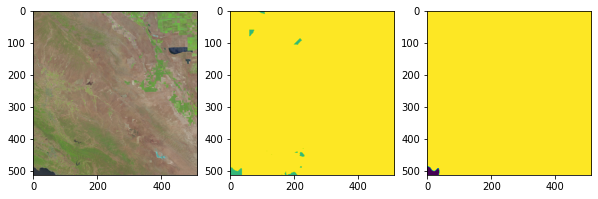

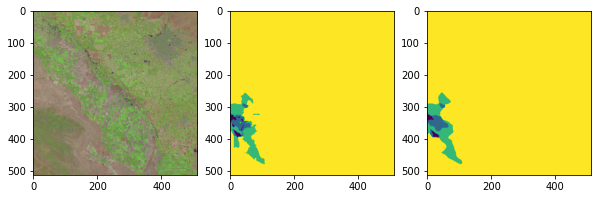

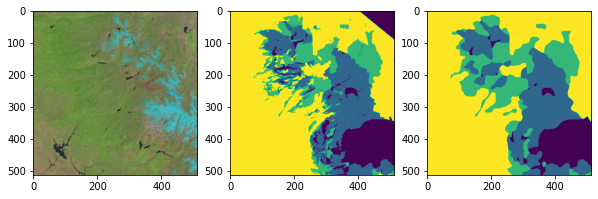

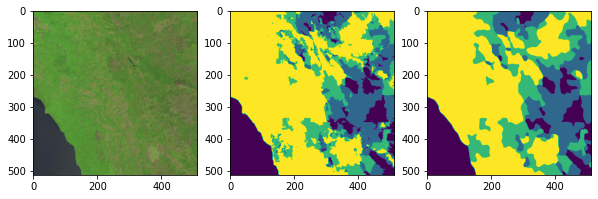

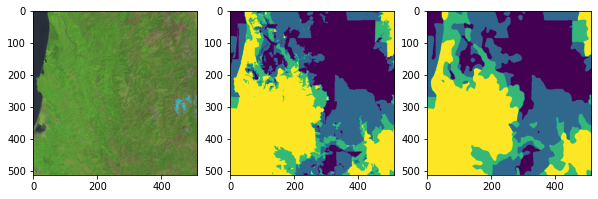

...

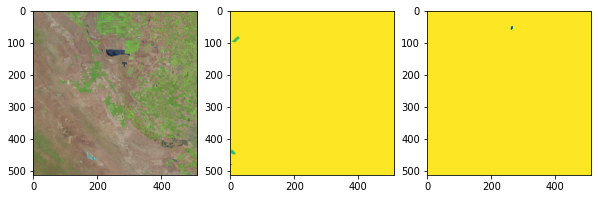

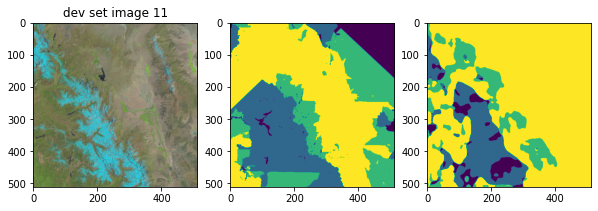

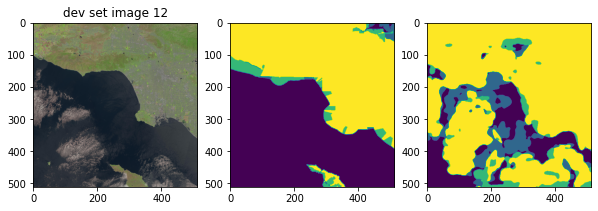

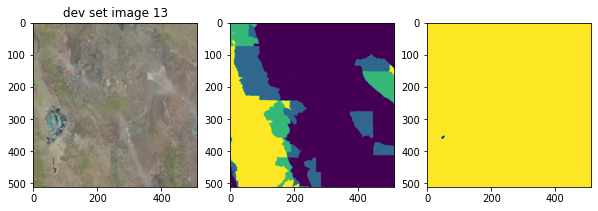

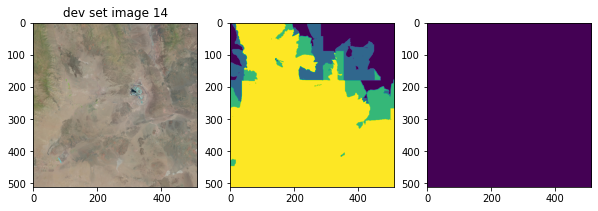

In [0]:
for i in range(0,15):
  pp.figure(figsize=(10,10))
  pp.subplot(133)
  pp.imshow(unet_model.predict(np.expand_dims(X[i],0))[0].argmax(-1))

  pp.subplot(132)
  pp.imshow(Y[i])

  pp.subplot(131)
  pp.imshow(X[i])
  if i > N_TRAIN:
    pp.title("dev set image {}".format(i))